# Anxiety Attack : Factors, Symptoms, and Severity

Esse projeto consiste em demonstar algumas técnicas de análise e ciência de dados em cima de uma banco de dados com o tema de "crise de ansiedade". O projeto partiu de uma iniciativa de buscar um tema não trabalhado no curso Cientista de Dados ofertado pela EBAC, e explorar datasets para tirar insights novos.

## O que esperar com esse dataset?
> O data set contem 12000+ informações com fatores externos incluindo dados demográficos, hábitos de vida, níveis de estresse e respostas fisiológicas. Ele foi projetado para análise de dados, aprendizado de máquina e pesquisa em saúde mental, ajudando a explorar padrões, gatilhos e correlações potenciais em transtornos de ansiedade.

## Entendimento dos dados
O dataset conta com 20 variáveis no total, sendo 19 variáveis explicativas e 1 variável *target*. A variável *target* está destacada em negrito e as demais variáveis explicadas na tabela a seguir.

### Dicionario dos dados

| Variável                | Descrição                                           | Tipo         |
| ----------------------- |:---------------------------------------------------:| ------------:|
| ID                      |  Identificação de cada individuo no estudo          | int64|
| Age                     |  Idade do individuo em anos                         | int64|
| Gender                  |  Male and female                                    | object|
| Occupation              |  Profissão exercida                                 | object|
| Sleep Hours             |  Quantidade de horas dormidas por dia               | float64|
| Physical Activity       |  Quantidade de atividade fisica (hrs/semana)        | float64|
| Caffeine Intake         |  Cafeína ingedida em mg/dia                         | int64|
| Alcohol Consumption     |  Número de drinks ingeridos por semana              | int64|
| Smoking                 |  Fumante = 'Yes'; Não Fumante = 'No'                | object|
| Family History of Anxiety|  Historio de ansiedade na familia 'Yes, No'        | object|
| Stress Level            |  Nícel de estresse  (1-10)                          | int64|
| Heart Rate              |  Batimentos por minutos durante um ataque           | int64|
| Breathing Rate          |  Respirações por minuto                             | int64|
| Sweating Level          |  Nível de suor (1-5)                                | int64|
| Dizziness               |  Apresentou tontura? 'Yes, No'                      | object|
| Medication              |  Faz uso de medicação? 'Yes, No'                    | object|
| Therapy Sessions        |  Quantidade de sessões de terapia no mês            | int64|
| Recent Major Life Event |  Passou por um evento importante recentemente?      | object|
| Diet Quality            |  Qualidade da dieta (1-10)                                | int64|
| **Severity of Anxiety Attack**|  Gravidade da crise de ansiedade (1-10)              | int64|



#### Carregando os pacotes

In [6]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.cluster import KMeans
from scipy.stats import ttest_ind
from sklearn.metrics import silhouette_score
from tqdm.notebook import tqdm

from xgboost import XGBClassifier

import warnings
warnings.filterwarnings('ignore')

#### Carregando os dados
Os dados estão no formato .csv

In [8]:
df = pd.read_csv('./anxiety_attack_dataset.csv')
df.head(5)

,ID,Age,Gender,Occupation,Sleep Hours,Physical Activity (hrs/week),Caffeine Intake (mg/day),Alcohol Consumption (drinks/week),Smoking,Family History of Anxiety,Stress Level (1-10),Heart Rate (bpm during attack),Breathing Rate (breaths/min),Sweating Level (1-5),Dizziness,Medication,Therapy Sessions (per month),Recent Major Life Event,Diet Quality (1-10),Severity of Anxiety Attack (1-10)
0,1,56,Female,Other,9.6,8.3,175,6,No,No,4,145,33,3,No,No,4,Yes,9,10
1,2,46,Male,Teacher,6.4,7.3,97,6,No,No,3,143,18,5,Yes,No,0,No,9,8
2,3,32,Female,Doctor,6.9,1.0,467,14,No,No,2,60,34,1,No,No,7,Yes,10,5
3,4,60,Male,Doctor,9.2,3.7,471,16,No,Yes,6,94,19,1,No,Yes,4,Yes,5,8
4,5,25,Male,Student,9.2,2.5,364,2,No,Yes,7,152,15,4,No,Yes,0,No,1,1


In [9]:
df.shape

(12000, 20)

In [10]:
# Conferindo existência de valores nulos
df.isnull().sum()

ID                                   0
Age                                  0
Gender                               0
Occupation                           0
Sleep Hours                          0
Physical Activity (hrs/week)         0
Caffeine Intake (mg/day)             0
Alcohol Consumption (drinks/week)    0
Smoking                              0
Family History of Anxiety            0
Stress Level (1-10)                  0
Heart Rate (bpm during attack)       0
Breathing Rate (breaths/min)         0
Sweating Level (1-5)                 0
Dizziness                            0
Medication                           0
Therapy Sessions (per month)         0
Recent Major Life Event              0
Diet Quality (1-10)                  0
Severity of Anxiety Attack (1-10)    0
dtype: int64

#### Entendimento dos dados - Univariada
Nesta etapa tipicamente avaliamos a distribuição de todas as variáveis. 

Gender
Female    5809
Male      5723
Other      468
Name: count, dtype: int64


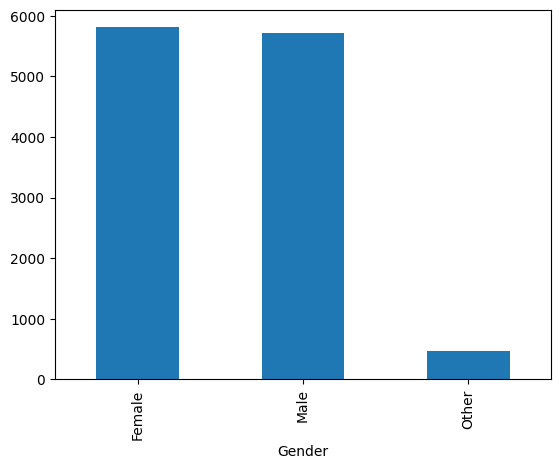

In [12]:
#Distribuição de homens e mulheres no dataset
g_b_gen = df['Gender'].value_counts().plot.bar()
print(df['Gender'].value_counts())

> O dataset está bem distribuido, sendo 5809 pessoas do genero feminino, 5723 do genero masculino e 468 pessoas que não se identificaram.

Age
18    246
19    264
20    252
21    262
22    239
23    250
24    227
25    255
26    251
27    250
28    252
29    258
30    280
31    234
32    257
33    266
34    284
35    270
36    260
37    245
38    258
39    263
40    279
41    256
42    269
43    295
44    213
45    273
46    274
47    243
48    231
49    261
50    267
51    246
52    265
53    248
54    261
55    242
56    260
57    237
58    242
59    262
60    238
61    247
62    268
63    226
64    274
Name: count, dtype: int64


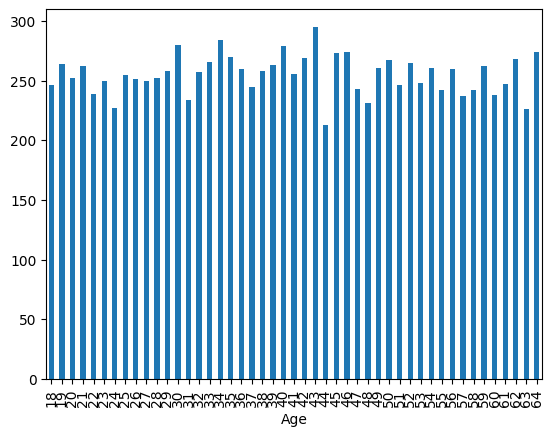

In [14]:
g_b_age = df['Age'].value_counts().sort_index().plot.bar()
print(df['Age'].value_counts().sort_index())

> A quantidade de pessoas em cada idade está bem distribuida. É possivel ver que a faixa de idades começa com 18 anos e termina com 64 anos.

Occupation
Unemployed    2139
Doctor        2004
Teacher       1980
Other         1971
Student       1953
Engineer      1953
Name: count, dtype: int64


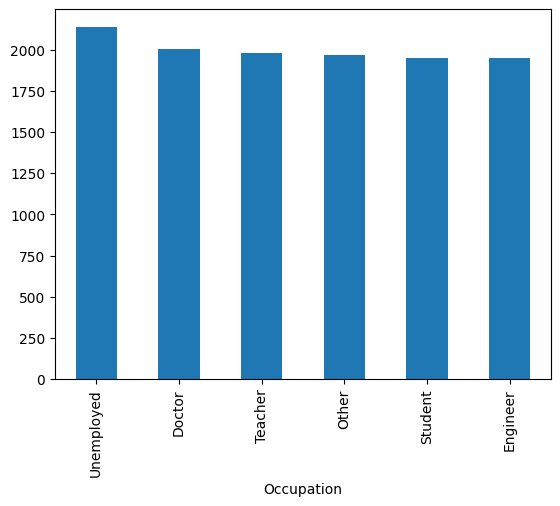

In [17]:
g_b_occ = df['Occupation'].value_counts().plot.bar()
print(df['Occupation'].value_counts())

> Não há nenhuma profissão que se destaca em quantidade, porem é possivel ver que existem muitas pessoas desempregadas.

<Axes: ylabel='Physical Activity (hrs/week)'>

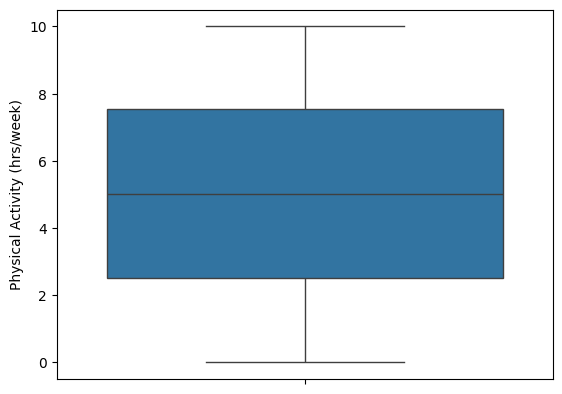

In [23]:
sns.boxplot(y = 'Physical Activity (hrs/week)', data = df)

> Utilizando um boxplot, é possivel conferir que a media de atividade fisica na semana é de 5 horas.

<Axes: ylabel='Caffeine Intake (mg/day)'>

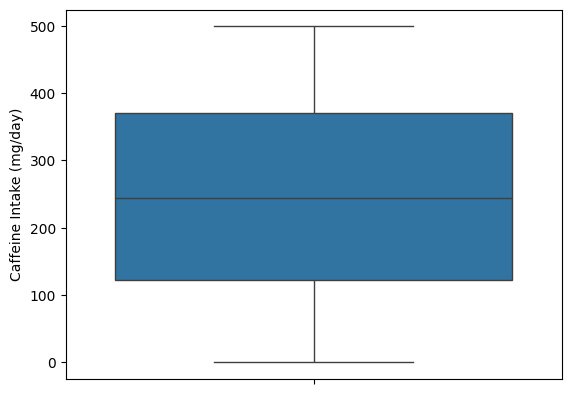

In [26]:
sns.boxplot(y = 'Caffeine Intake (mg/day)', data = df)

> A media de ingestão de cafeina é aproximadamente 250 mg ao dia.

Smoking
No     8417
Yes    3583
Name: count, dtype: int64


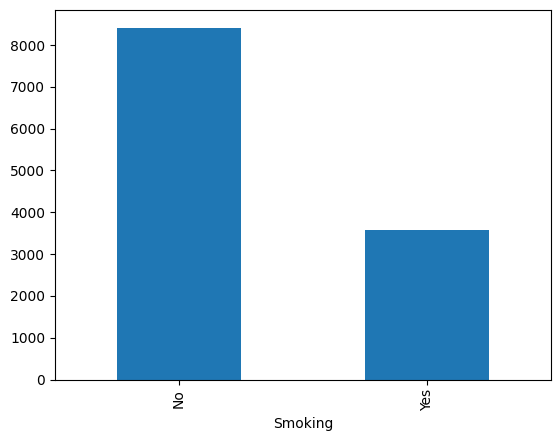

In [30]:
#Grafico de barras com a distribuiçao de fumantes
g_b_smk = df['Smoking'].value_counts().plot.bar()
print(df['Smoking'].value_counts())

> No dataset vemos que a maioria das pessoas não são fumantes.

Family History of Anxiety
No     7179
Yes    4821
Name: count, dtype: int64


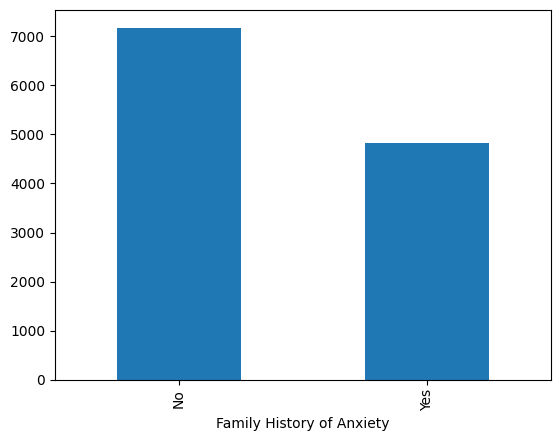

In [33]:
#Grafico de barras com a distribuiçao de pessoas com historico de ansiedade na familia
g_b_fha = df['Family History of Anxiety'].value_counts().plot.bar()
print(df['Family History of Anxiety'].value_counts())

> Em sua maior parte, não existe historico de ansiedade conhecido nos familiares. 

Medication
No     9605
Yes    2395
Name: count, dtype: int64


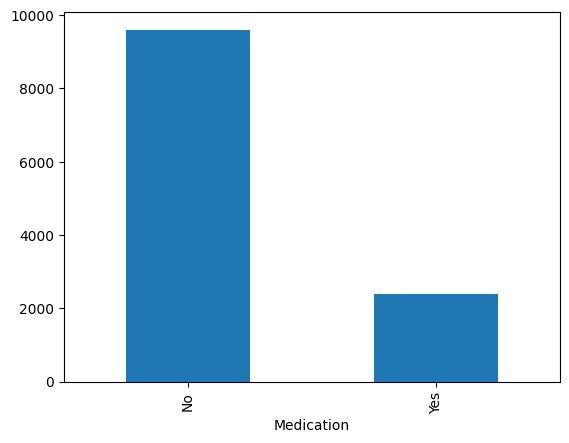

In [37]:
#Grafico de barras com a distribuiçao de pessoas com o uso de medicamentos
g_b_med = df['Medication'].value_counts().plot.bar()
print(df['Medication'].value_counts())

> A minoria das pessoas utilizam medicamentos para ansiedade

Severity of Anxiety Attack (1-10)
5     1254
7     1224
6     1224
4     1202
1     1201
9     1191
10    1187
8     1187
2     1175
3     1155
Name: count, dtype: int64


<Axes: ylabel='count'>

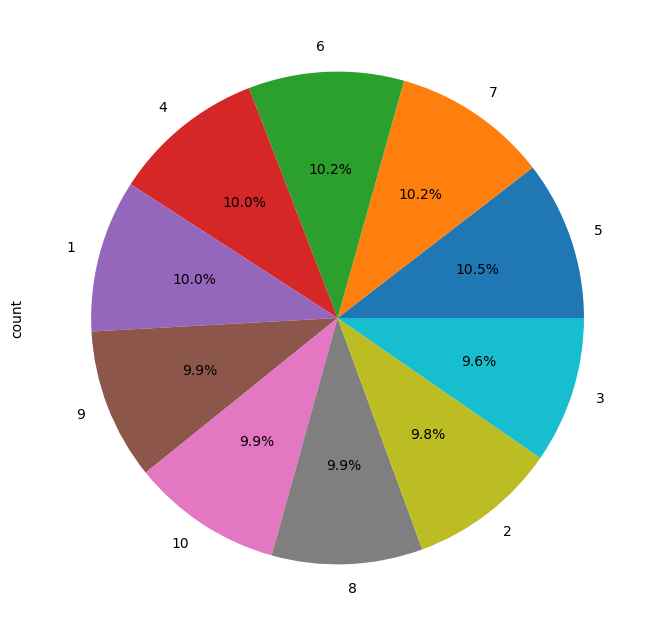

In [40]:
Anxiety_attack_distribution = df['Severity of Anxiety Attack (1-10)'].value_counts()
print(Anxiety_attack_distribution)
Anxiety_attack_distribution.plot(kind='pie', autopct='%1.1f%%', figsize=(8, 8))

> Dentro do dataset, temos pessoas com todos os niveis de severidade de crise, e estão bem distribuidas.

#### Agora vamos partir para o entendimento dos dados através de bivariadas

In [44]:
#criando um novo dataframe com a variavel idade categorizada
df1 = df.copy()
df1['Age_cat'] = pd.qcut(df.Age, q=10)
df1['Phys_act_cat'] = pd.qcut(df['Physical Activity (hrs/week)'], q=10)

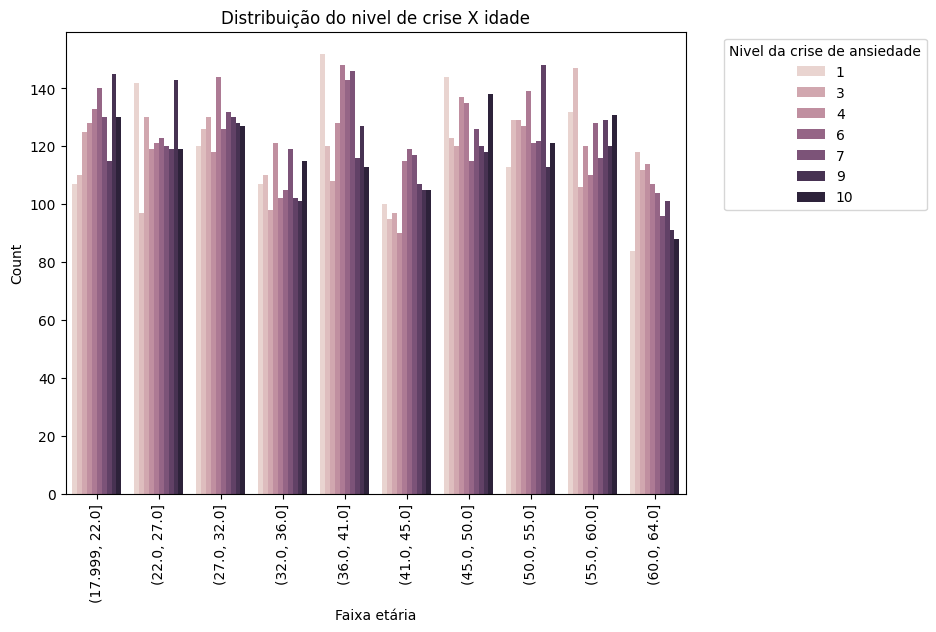

In [46]:
plt.figure(figsize=(8, 6))
sns.countplot(x='Age_cat', hue='Severity of Anxiety Attack (1-10)', data=df1)
plt.title('Distribuição do nivel de crise X idade')
plt.xlabel('Faixa etária')
plt.ylabel('Count')
plt.legend(title='Nivel da crise de ansiedade', loc = 'upper right', bbox_to_anchor=(1.4,1))
plt.xticks(rotation=90)
plt.show()

> O gráfico mostra uma distribuição bem proxima entre as faixas etarias, porem, visualmente, já podemos perceber que a faixa etária dos idosos 60+, apresentam um numero menor de pessoas com o Nivel de ansiedade alto, e pessoaso mais jovens entre [18, 27] anos e de [45,55] anos possuiem entre sua faixa etaria mais pessoas com niveis mais altos de ansiedade. 

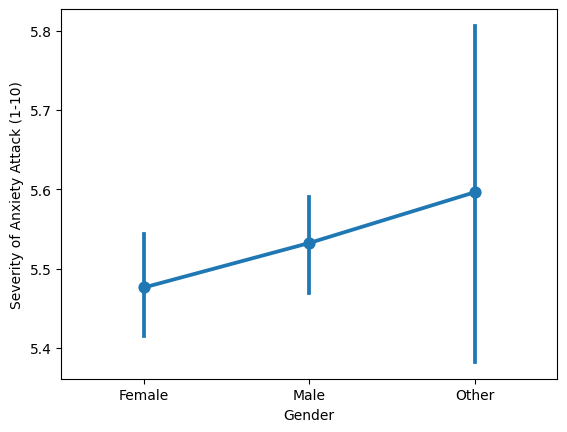

In [48]:
#Qual sexo tem casos mais graves de ansiedade?
gender_ansiedade = sns.pointplot(x='Gender', y='Severity of Anxiety Attack (1-10)',
                     data=df, dodge=True, errorbar =('ci', 90))

> Notasse que pessoas do sexo masculino possuem uma leve tendencia a ter mais crises de ansiedade que pessoas do sexo feminino. Já as pessoas que não se identificaram com um gênero possuem um desvio entre os dados muito grande.

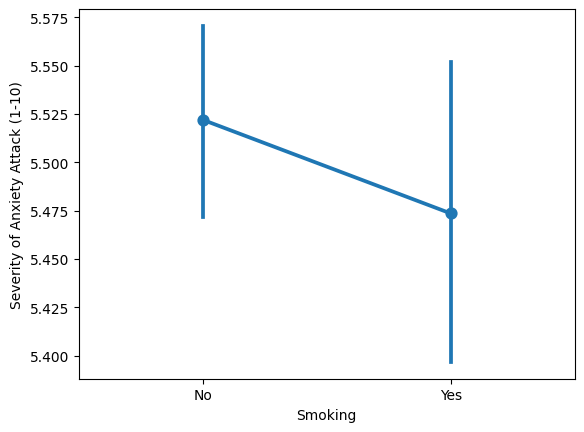

In [52]:
#Pessoas fumantes são mais propensas a ataques graves de ansiedade?
gender_ansiedade = sns.pointplot(x='Smoking', y='Severity of Anxiety Attack (1-10)',
                     data=df, dodge=True, errorbar =('ci', 90))

> Apesar da grande variação entre as pessoas fumantes, a primeira vista pessoas que fumam estão menos propensas a ataques de ansiedade mais graves.

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, '(17.999, 22.0]'),
  Text(1, 0, '(22.0, 27.0]'),
  Text(2, 0, '(27.0, 32.0]'),
  Text(3, 0, '(32.0, 36.0]'),
  Text(4, 0, '(36.0, 41.0]'),
  Text(5, 0, '(41.0, 45.0]'),
  Text(6, 0, '(45.0, 50.0]'),
  Text(7, 0, '(50.0, 55.0]'),
  Text(8, 0, '(55.0, 60.0]'),
  Text(9, 0, '(60.0, 64.0]')])

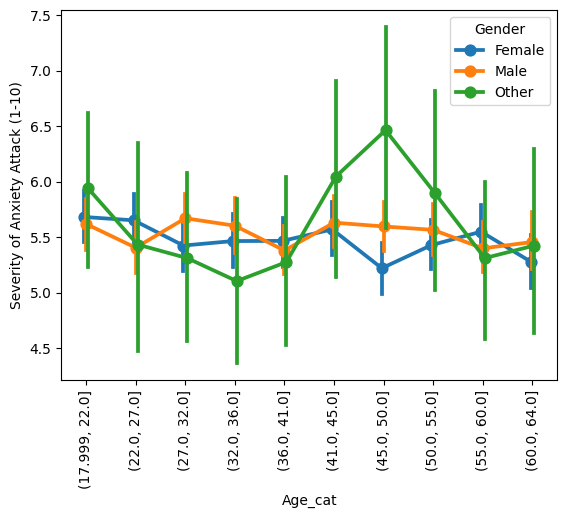

In [55]:
#verificando os perfis por idade e genero
ax = sns.pointplot(x="Age_cat", y="Severity of Anxiety Attack (1-10)", hue = 'Gender',
                   data=df1, dodge=True, errorbar=('ci',95))
plt.xticks(rotation=90)

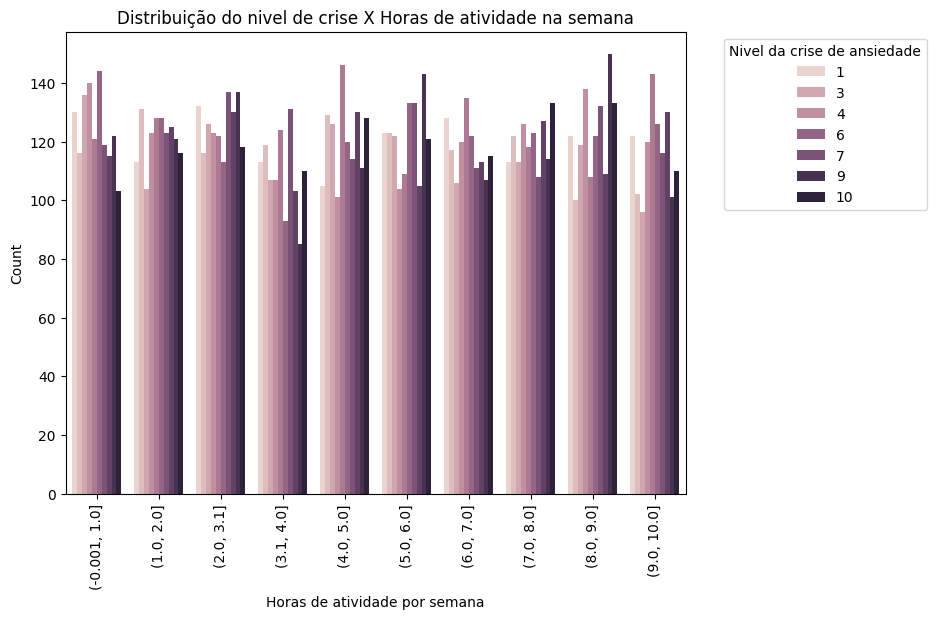

In [56]:
plt.figure(figsize=(8, 6))
sns.countplot(x='Phys_act_cat', hue='Severity of Anxiety Attack (1-10)', data=df1)
plt.title('Distribuição do nivel de crise X Horas de atividade na semana')
plt.xlabel('Horas de atividade por semana')
plt.ylabel('Count')
plt.legend(title='Nivel da crise de ansiedade', loc = 'upper right', bbox_to_anchor=(1.4,1))
plt.xticks(rotation=90)
plt.show()

<Axes: >

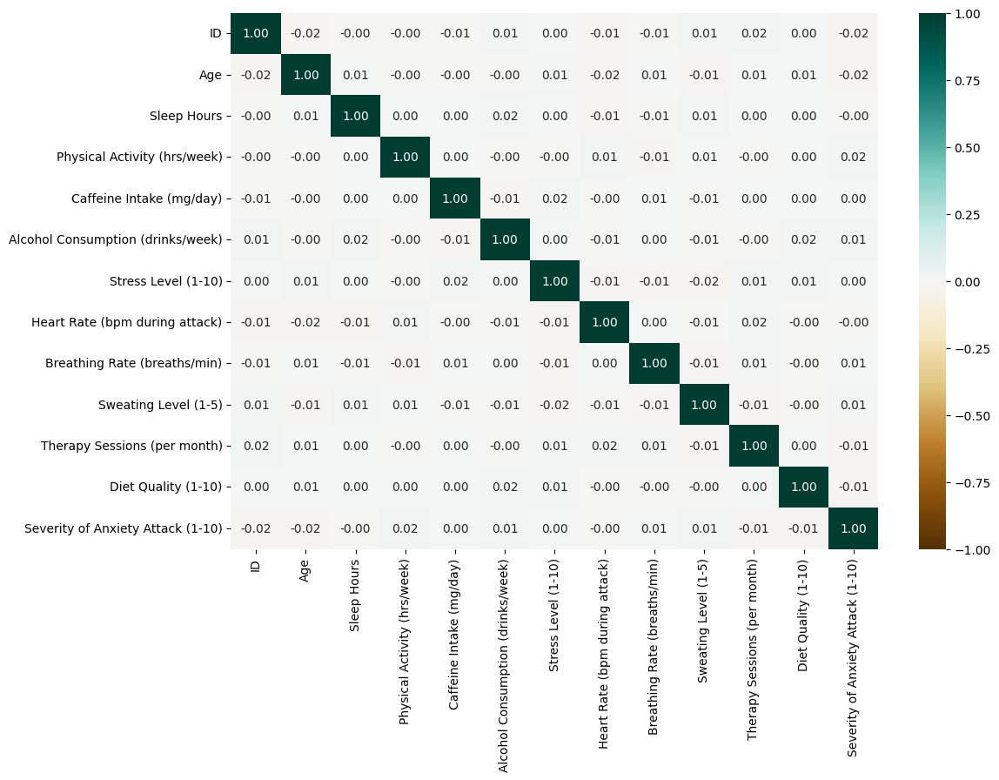

In [57]:
#Verificando a correlaçao entre as variaveis
plt.figure(figsize=(12, 8))
corr_matrix = df.select_dtypes(include=['float64', 'int64']).corr()
sns.heatmap(corr_matrix, annot=True, fmt='.2f', vmin=-1, vmax=1, cmap = 'BrBG')

> As variaveis não apresentaram correlações entre si, podendo indicar que os dados foram gerados de forma aleatoria, não apresentando padrões.

## Machine Learning

In [61]:
df2 = df.copy()
df2 = pd.get_dummies(df2)

### Train test split

In [64]:
X = df2.drop('Severity of Anxiety Attack (1-10)',axis = 1)
y = df2['Severity of Anxiety Attack (1-10)']

In [65]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
print(X_train.shape,X_test.shape)

(9000, 31) (3000, 31)


### Random Forest

In [71]:
rf_model = RandomForestClassifier().fit(X_train, y_train)

In [72]:
y_pred = rf_model.predict(X_test)
rf_accuracy = accuracy_score(y_test, y_pred)
rf_accuracy

0.09633333333333334

### Logistic Regression

In [74]:
loj = LogisticRegression(solver = 'liblinear')
loj_model = loj.fit(X, y)

In [75]:
y_pred = loj_model.predict(X)
lr_accuracy = accuracy_score(y, y_pred)
lr_accuracy

0.12183333333333334

### KNN

In [77]:
knn = KNeighborsClassifier()
knn_model = knn.fit(X_train, y_train)

In [78]:
y_pred = knn_model.predict(X_test)
knn_accuracy = accuracy_score(y_test, y_pred)
knn_accuracy

0.099

### ANN

In [80]:
scaler = StandardScaler()

In [81]:
scaler.fit(X_train)

StandardScaler()

In [83]:
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [85]:
mlpc = MLPClassifier().fit(X_train_scaled, y_train)

In [86]:
y_pred = mlpc.predict(X_test_scaled)
ann_accuracy = accuracy_score(y_test, y_pred)
ann_accuracy

0.10033333333333333

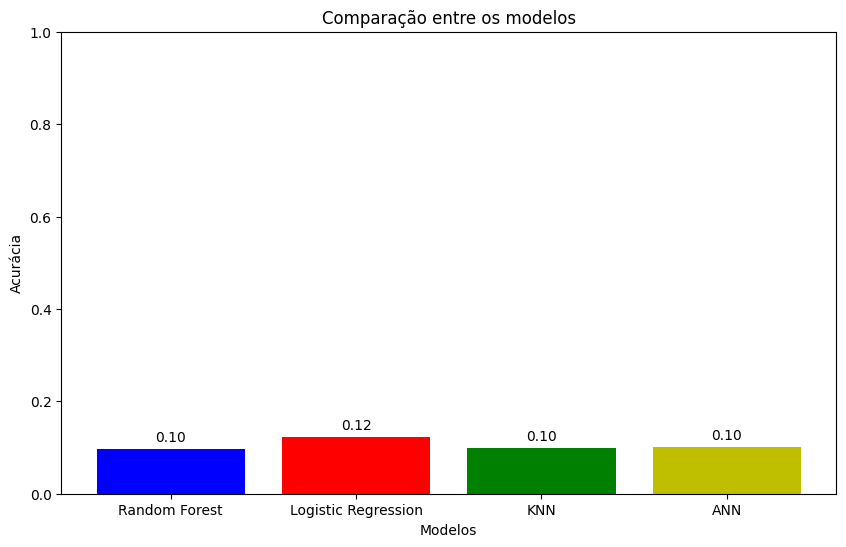

In [87]:
models = ['Random Forest','Logistic Regression', 'KNN', 'ANN']
accuracies = [rf_accuracy,lr_accuracy, knn_accuracy, ann_accuracy,]

plt.figure(figsize=(10, 6))
bars = plt.bar(models, accuracies, color = ["b","r","g","y"])
plt.xlabel('Modelos')
plt.ylabel('Acurácia')
plt.title('Comparação entre os modelos')
plt.ylim(0, 1)

for bar, accuracy in zip(bars, accuracies):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, f'{accuracy:.2f}', ha='center', va='bottom')

plt.show()

## Algumas considerações

Apesar de ser um dataset bastante robusto, com muitas variaveis e amostras, o dataset apresenta-se com uma ausencia de padroes, uma vez que os dados aparentemente foram gerados randomicamente. Analisando as variaveis que conhecemos popularmente por ajudar a diminuir a ansiedade como a prática de atividades fisicas não se confirmaram. 

Ao gerar a matriz de correlação fica mais evidente a aleatoriedade de cada dado, não sendo possível chegar a uma conclusão solida. As variaveis estão sempre bem distribuidas entre si.

Já entrando no aprendizado de máquina, foi possivel notar que a acurácia de todos os modelos testados foram bem baixas, destando o modelo de regressão logística pelo melhor resultado entre modelos testados.

## Modelo descritivo
Como não foi possivel denifinir uma taxa alta de predição dos dados, vamos fazer um outro tipo de analise utilizando um modelo descritivo.<br/>
<br/>Métodos de agrupamento, em comparação com técnicas de classificação como árvores de decisão e random forest, carregam uma subjetividade consideravelmente maior. A compreensão profunda do negócio se torna crucial nesse contexto. Ao definir quais variáveis serão incluídas no modelo, estamos influenciando diretamente os resultados. Essa decisão deve ser guiada pelo objetivo do negócio.

Por exemplo, se o objetivo é identificar padrões de consumo, variáveis como dados biométricos ou financeiros do cliente podem ser irrelevantes. No entanto, se o foco é analisar o desempenho de atletas, as prioridades podem ser completamente diferentes.

In [100]:
X_pad = pd.DataFrame(StandardScaler().fit_transform(X_train), columns = X_train.columns)

X_pad['y'] = y_train

### Seleção de variaveis

Objetivo principal: capturar padrões de estilos de vida que possam levar a pessoa a ter um índice maior de ansiedade.

In [103]:
med_por_grupo = X_pad.groupby('y').median()
med_por_grupo.drop(columns='ID',inplace = True)

In [104]:
med_por_grupo

,Age,Sleep Hours,Physical Activity (hrs/week),Caffeine Intake (mg/day),Alcohol Consumption (drinks/week),Stress Level (1-10),Heart Rate (bpm during attack),Breathing Rate (breaths/min),Sweating Level (1-5),Therapy Sessions (per month),...,Smoking_No,Smoking_Yes,Family History of Anxiety_No,Family History of Anxiety_Yes,Dizziness_No,Dizziness_Yes,Medication_No,Medication_Yes,Recent Major Life Event_No,Recent Major Life Event_Yes
y,,,,,,,,,,,,,,,,,,,,,
1.0,0.009939,0.014270,0.122747,0.008583,0.086554,-0.157882,-0.009378,0.075017,0.006346,-0.180587,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
2.0,0.009939,0.014270,0.088083,-0.029542,0.086554,0.187426,-0.066930,-0.048456,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
3.0,-0.064600,-0.084825,-0.085233,-0.071134,-0.086708,0.187426,-0.038154,0.075017,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
4.0,-0.064600,-0.035278,0.036088,-0.057270,-0.086708,0.187426,0.033786,-0.048456,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
5.0,-0.139139,-0.084825,0.053420,0.025913,-0.086708,-0.157882,-0.095706,-0.048456,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
6.0,0.009939,0.014270,-0.085233,0.012049,0.086554,-0.157882,-0.009378,-0.048456,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
7.0,0.084477,0.014270,0.122747,-0.001815,-0.086708,0.187426,0.105727,0.075017,0.006346,0.168786,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
8.0,-0.027331,0.063817,-0.015907,-0.064202,0.086554,-0.157882,-0.095706,-0.048456,0.006346,-0.180587,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758
9.0,0.009939,0.063817,-0.085233,-0.057270,-0.086708,-0.157882,-0.038154,-0.048456,0.006346,-0.180587,...,0.650846,-0.650846,0.820092,-0.820092,0.65448,-0.65448,0.499826,-0.499826,0.573758,-0.573758


In [105]:
colunas =['Age', 'Sleep Hours', 'Physical Activity (hrs/week)',
       'Caffeine Intake (mg/day)', 'Alcohol Consumption (drinks/week)',
       'Stress Level (1-10)', 'Heart Rate (bpm during attack)', 'Diet Quality (1-10)', 'Gender_Female',
       'Gender_Male']

In [106]:
colunas2 = list(colunas) + ['y']
colunas2

['Age',
 'Sleep Hours',
 'Physical Activity (hrs/week)',
 'Caffeine Intake (mg/day)',
 'Alcohol Consumption (drinks/week)',
 'Stress Level (1-10)',
 'Heart Rate (bpm during attack)',
 'Diet Quality (1-10)',
 'Gender_Female',
 'Gender_Male',
 'y']

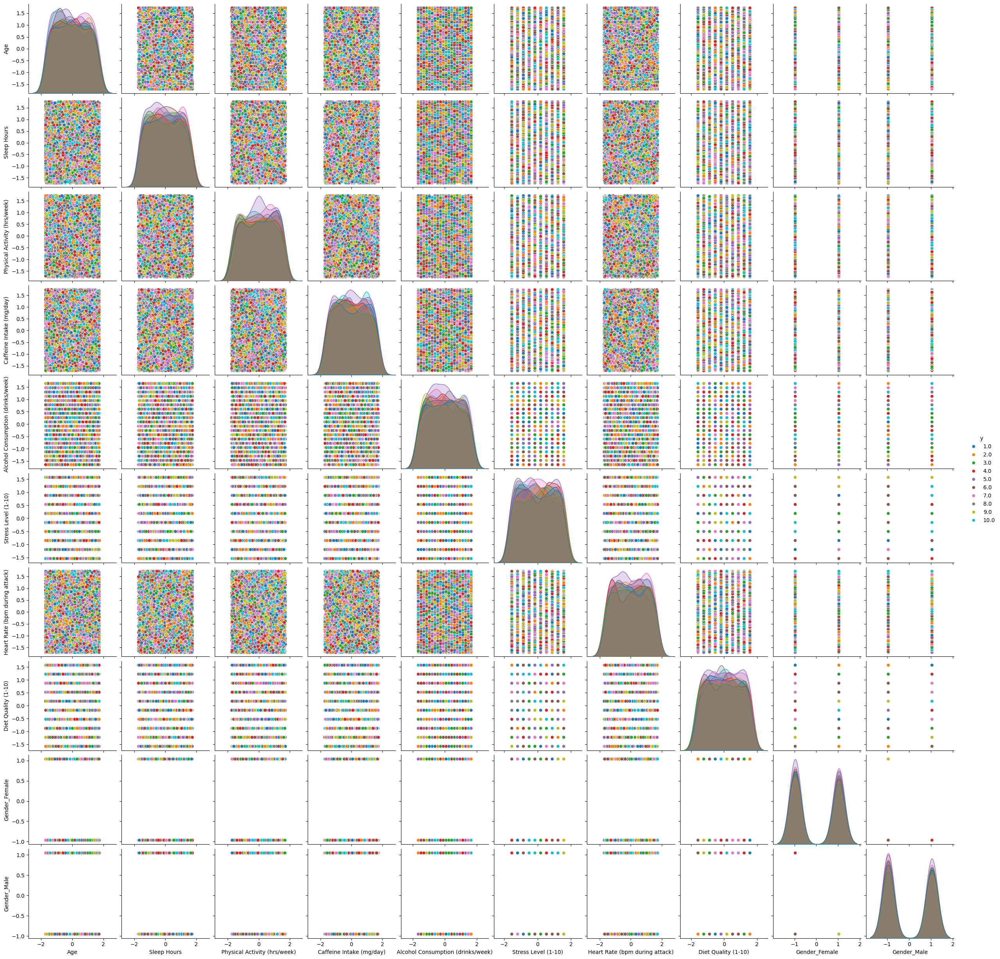

In [107]:
sns.pairplot(X_pad[colunas2], hue='y',palette='tab10')

### Aplicando o K-Means

In [109]:
cluster = KMeans(n_clusters=10)
cluster.fit_predict(X_pad[colunas])

array([5, 2, 2, ..., 6, 0, 6])

In [110]:
cluster.labels_

array([5, 2, 2, ..., 6, 0, 6])

In [111]:
X_pad['grupos'] = pd.Categorical(cluster.labels_)
colunas3 = list(colunas) + ['grupos']

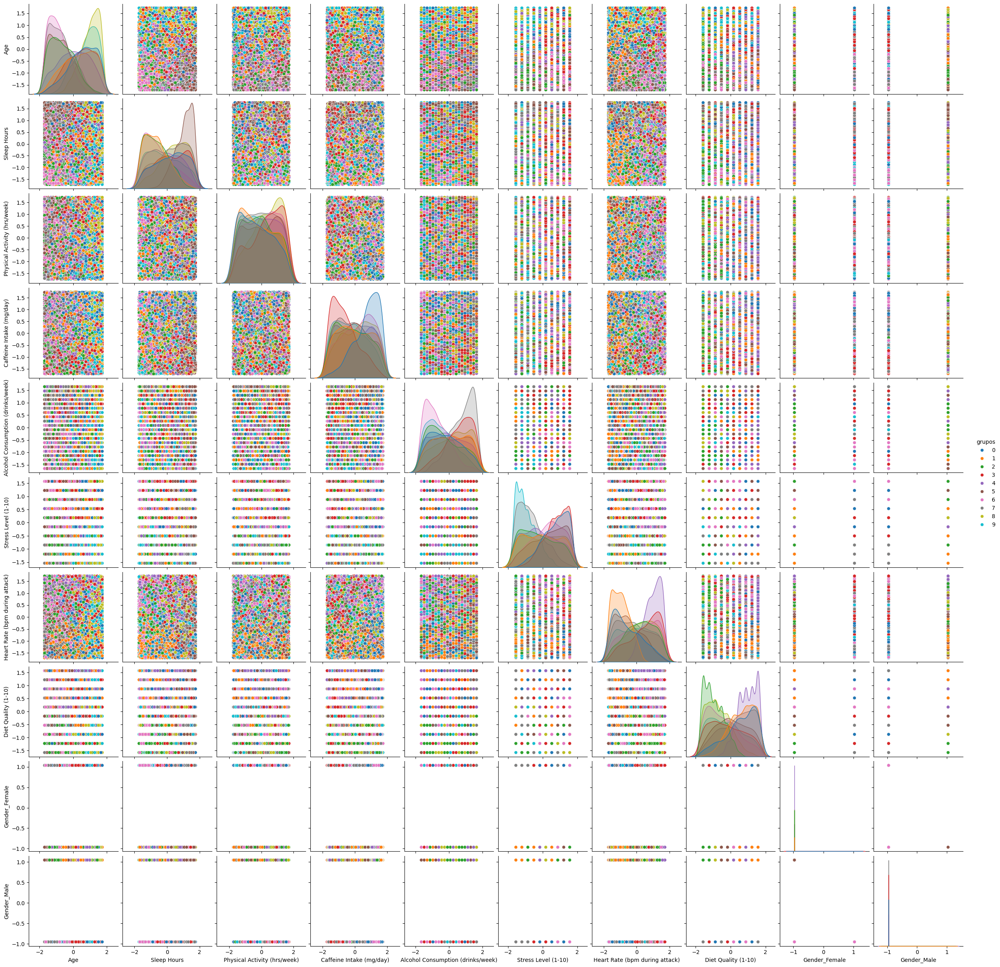

In [113]:
sns.pairplot(X_pad[colunas3], hue='grupos')

In [114]:
pd.crosstab(X_pad.y, X_pad.grupos)

grupos,0,1,2,3,4,5,6,7,8,9
y,,,,,,,,,,
1.0,56,61,61,66,68,67,50,91,73,65
2.0,62,67,54,71,56,64,66,70,67,58
3.0,61,63,70,60,72,75,68,53,59,60
4.0,50,81,59,63,75,72,78,60,51,69
5.0,64,72,78,65,78,76,86,77,70,74
6.0,64,69,63,59,75,65,74,73,70,68
7.0,76,62,65,78,72,64,71,81,84,67
8.0,70,63,54,55,70,69,61,86,67,69
9.0,68,56,68,61,70,63,80,69,60,68


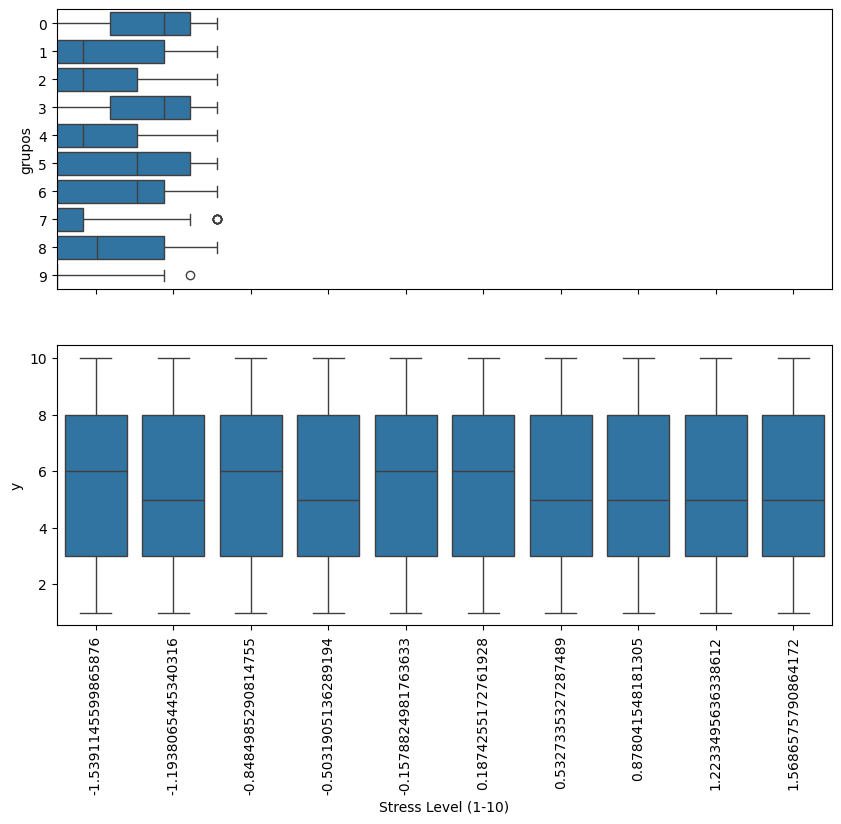

In [115]:
def dataviz_grupos(varx):
    fig, ax = plt.subplots(2, 1, sharex=True, figsize=(10, 8))

    sns.boxplot(data=X_pad, y='grupos', x=varx, ax=ax[0])
    sns.boxplot(data=X_pad, y='y', x='Stress Level (1-10)', ax=ax[1])
    plt.xticks(rotation=90)
    plt.show()

dataviz_grupos(colunas[5])

### Utilizando o método do cotovelo para definir o numero de clusters

In [117]:
SQD = []
K = range(1,15)
for k in tqdm(K):
    km = KMeans(n_clusters=k)
    km = km.fit(X_pad[colunas])
    SQD.append(km.inertia_)

  0%|          | 0/14 [00:00<?, ?it/s]

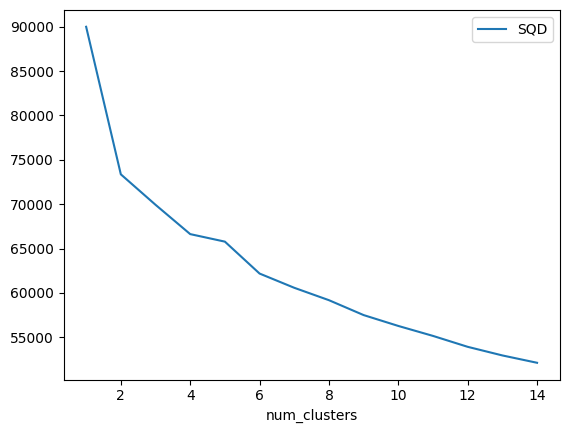

In [118]:
df = pd.DataFrame({'num_clusters': list(range(1, len(SQD)+1)), 'SQD': SQD})
df.plot(x = 'num_clusters', y = 'SQD');

In [119]:
cluster = KMeans(n_clusters=4)
cluster.fit_predict(X_pad[colunas])

array([1, 1, 3, ..., 0, 0, 0])

In [120]:
cluster.labels_

array([1, 1, 3, ..., 0, 0, 0])

In [121]:
X_pad['grupos'] = pd.Categorical(cluster.labels_)
colunas4 = list(colunas) + ['grupos']

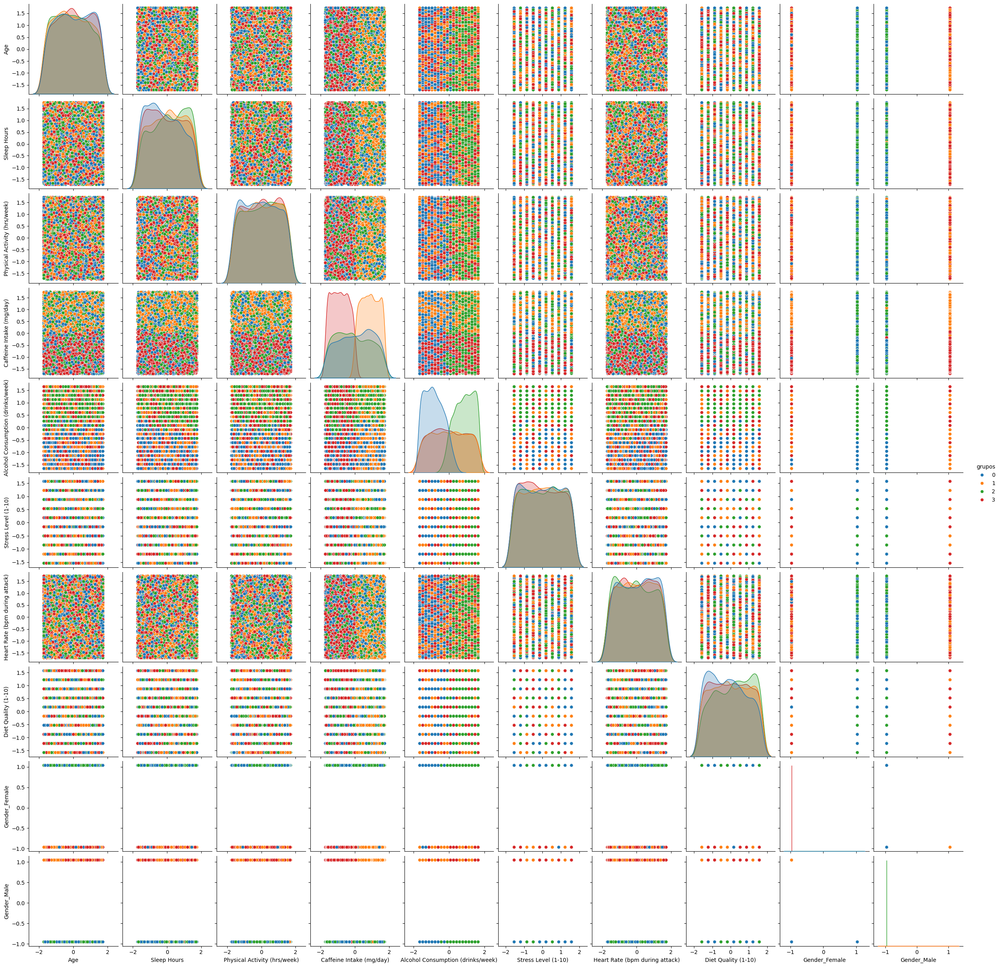

In [122]:
sns.pairplot(X_pad[colunas4], hue='grupos')

In [123]:
pd.crosstab(X_pad.y, X_pad.grupos)

grupos,0,1,2,3
y,,,,
1.0,145,162,176,175
2.0,151,152,176,156
3.0,164,169,136,172
4.0,169,162,154,173
5.0,188,205,169,178
6.0,169,165,171,175
7.0,193,159,177,191
8.0,167,156,168,173
9.0,192,147,155,169


### Separando a variavel y em classes

Foi separado em 3 grupos:
- Pessoas que tinham ataque de ansiedade de 1 a 4, foram classificadas como ataque "leve".
- Pessoas que tinham ataque de ansiedade de 5 a 7, foram classificadas como ataque "medio".
- Pessoas que tinham ataquede ansiedade superior a 8, foram classificadas como ataque "alto".

In [126]:
y_train

11675    10
10950     8
4256      9
10088     1
9030      5
         ..
11964     1
5191      9
5390      7
860       2
7270      3
Name: Severity of Anxiety Attack (1-10), Length: 9000, dtype: int64

In [127]:
y_train_cat = y_train.replace({1:'leve' , 2:'leve', 3: 'leve', 4:'leve', 5:'medio', 6:'medio',7:'medio',8:'alto',9:'alto',10:'alto'})

In [130]:
y_train_cat

11675     alto
10950     alto
4256      alto
10088     leve
9030     medio
         ...  
11964     leve
5191      alto
5390     medio
860       leve
7270      leve
Name: Severity of Anxiety Attack (1-10), Length: 9000, dtype: object

In [132]:
X_pad['y'] = y_train_cat

In [133]:
colunas5 =['Age','Physical Activity (hrs/week)',
       'Stress Level (1-10)']

Verificando o novo agrupamento com 3 clusters

In [140]:
cluster = KMeans(n_clusters=3)
cluster.fit_predict(X_pad[colunas5])

array([2, 1, 0, ..., 2, 1, 1])

In [141]:
X_pad['grupos'] = pd.Categorical(cluster.labels_)
colunas5 = list(colunas) + ['grupos']

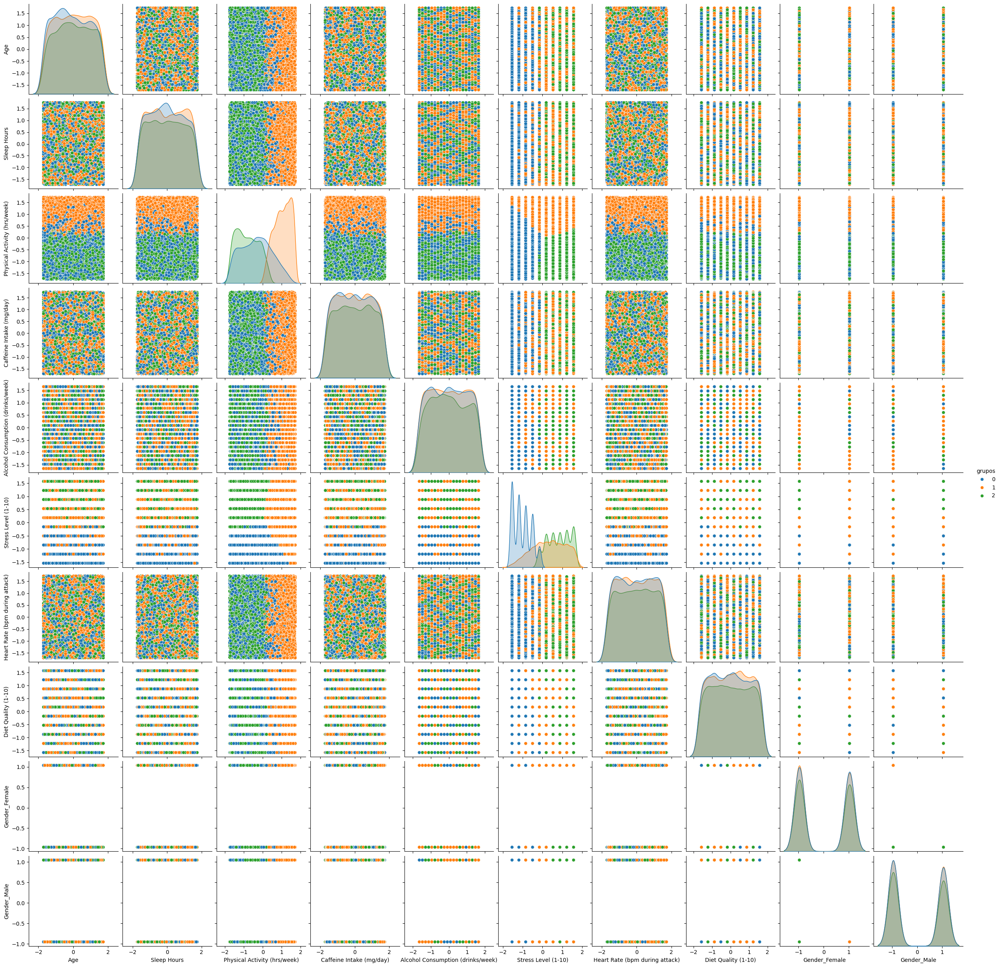

In [142]:
sns.pairplot(X_pad[colunas5], hue='grupos')

In [143]:
pd.crosstab(X_pad.y, X_pad.grupos)

grupos,0,1,2
y,,,
alto,756,659,598
leve,856,946,790
medio,719,771,650


In [173]:
pd.crosstab(X_pad['Stress Level (1-10)'], X_pad.grupos)

grupos,0,1,2
Stress Level (1-10),,,
-1.539115,912,52,0
-1.193807,773,138,0
-0.848499,657,240,0
-0.503191,568,327,0
-0.157882,223,417,245
0.187426,0,411,458
0.532734,0,449,474
0.878042,0,379,477
1.223350,0,381,509


In [175]:
pd.crosstab(X_pad['Physical Activity (hrs/week)'], X_pad.grupos)

grupos,0,1,2
Physical Activity (hrs/week),,,
-1.749074,12,0,26
-1.714411,34,0,60
-1.679747,37,0,45
-1.645084,29,0,54
-1.610421,31,0,46
...,...,...,...
1.578607,1,81,0
1.613271,0,91,0
1.647934,0,97,0


## Insights

> Inicialmente o projeto teve como principal objetivo prever padrões e determinar o nível do ataque de ansiedade, porem após realizar as etapas de analise e machine learning, foi notado que não existia nenhuma váriavel com forte relação com a variável resposta. Sendo assim partimos de uma modelagem preditiva para uma análise mais descritiva, com o auxilio com K-means para separar as pessoas em determinados grupos.

> Utilizando o metodo do cotovelo separamos em 4 grupos que no fim não retornou uma divisão determinante. Em seguida separamos a variavel y em 3 classes, e como divisao tambem usamos 3 clusters, que graficamente nos retornou algo mais dividido visualmente, porem ao fazer o cruzamento dos com a variavel determinante de ansiedade, vimos que os grupos ainda permaneceram bem distribuidos.

> Entretanto quando olhamos para variaveis como nivel de stress ou atividade fisicas na semana, os grupos se dividiram de uma forma mais relevante.

> O principal objetivo desse projeto foi demonstrar tecnicas de modelagem de predição e descritiva, para tirar insights de um dataset. O dataset utilizado em si, por não possuir padrões os resultados não foram muito expressivos.